# Compte rendu de TP du 13/03 - Introduction LBM

### Importation des librairies

In [1]:
using LinearAlgebra    # For matrix computations
using Plots            # For plotting
using LaTeXStrings     # For writing LaTeX in code
using Interpolations   # For computing interpolation, useful for animation
using BenchmarkTools   # For Evaluating the performance of our code

### Code pour l'animation

Le code suivant permettra d'animer nos solutions au cours du temps.

In [2]:
function animation(sol::AbstractMatrix; d::Real = 5, fps::Int = 30, Lmax::Real, Lmin::Real, T::Real, label::String = "")

    # INPUTS
    #   - sol       : Solution Matrix given by the dynamics function,
    #   - d         : Duration wanted for the animation,
    #   - fps       : Number of frame per secondes,
    #   - Lmax      : Number of frame per secondes,
    #   - Lmin      : Number of frame per secondes,
    #   - T         : Final to time of the simulation to print the current physical time,

    # OUTPUTS
    #   - An animation of the solution through the time
    
    # Total frame
    nbframe = fps * d
  
    # Time and space vector
    Nₜ, Nₓ = size(sol)
    time = range(0,1,Nₜ)
    mesh = LinRange(Lmin,Lmax,Nₓ)
    
    # Constante to fix the yaxis
    M = max(sol...)
    m = min(sol...)

    anim = @animate for n in 1:nbframe
        # Actual frame
        t = n / (fps*d)
        # Interpolation
        interp= [linear_interpolation(time, sol[:,i])(t) for i in 1:Nₓ]
        # Plots
        plot(mesh, interp, ylim = [m*1.1^(m),M*1.1^(M)], c = :black, label = label)
        xlabel!(L"x")
        ylabel!(L"u")
        title!("t = "*string(round(t*T; digits = 3)))
    end
  
    gif(anim, fps = fps)
  end

animation (generic function with 1 method)

## **Exercice 1 :** Equation d'advection

Dans cette partie, on s'intéresse à l'équation d'advection : 
$$ \partial_t u + c\partial_x u =0,$$
où $c$ est réelle et constante au cours du temps.

In [3]:
# Advection
advection(u::Real, c::Real) = c*u

advection (generic function with 1 method)

### **Question 1**

Il faut que $m_1^{eq} = \varphi(m_0) = cm_0$ pour que le schéma soit consistant d'après le cours.

### **Question 2**

Pour le code, nous choisissons une discrétisation du domaine $[x_{min}, x_{max}]$ définie par $x_j = x_{min} + jΔx$ pour un pas d'espace $Δx > 0$ et $j∈\{0,\cdots, N_x \}$ où $N_x = \frac{x_{max}-x_{min}}{Δx} ∈ \mathbb{N}$. En d'autres termes il y a des points sur le bord du domaine. 

Nous avons choisis des conditions aux bords périodiques,i.e que nous avons $∀ n∈ \{1, \cdots, N_tΔt = T\}$ :
$$ f_0(nΔt, x_{max}) = f_0^*((n-1)Δt, x_{min}) \text{ et } f_1(nΔt, x_{min}) = f_1^*((n-1)Δt, x_{max}).$$ 
Mais elle ne servira pas vraiment en pratique.

Nous calculerons de trois façons nos solutions dans ce compte rendue :
1. On calcule les solutions à nombre de pas de temps $N_t$ donné sans se soucier de ce que vaut la valeur $\lambda$. 
2. On se donne une valeur de $λ$ et on calculera la solution jusque une valeur de temps $T'$ différente de celle initiale donnée afin de bien avoir la valeur de $\lambda$ que l'on se donne. On aura toute fois la relation :
$$ T' = R\left( \frac{λT}{Δx}\right) \frac{Δx}{λ}.$$ 
On utilisera surtout cette approche pour les calculs d'ordres de convergence.

3. On se donne une valeur de $λ$ et on calculera la solution malgré jusque la valeur de temps $T$ initiale donnée quitte faire les calculs pour une valeur $\lambda'$ différente de l'originale. On aura toute fois la relation :
$$\lambda' = R\left(\frac{λT}{Δx}\right)\frac{Δx}{T}.$$
où l'opérateur $R$ est l'opérateur arrondi à l'entier le plus proche. On utilisera surtout cette approche pour comparer et afficher les solutions à un temps donné lorsque une valeur de $\lambda$ exacte n'est pas requise.

In [4]:
# Initialisation
m_init(u₀::Vector, ϕ::Base.Callable) = transpose(hcat(u₀, equilibrium(u₀, ϕ)))
f_init(m::AbstractMatrix, λ::Real) = m2f(m,λ)

# Moment matrix
M(λ::Real) = [1 1; -λ λ]
Minv(λ::Real) = [0.5 -0.5*(1.0/λ); 0.5 0.5*(1.0/λ)]

# Conversion to moment
f2m(f::AbstractMatrix, λ::Real) = reduce(hcat, [M(λ) * f[:,i] for i in axes(f)[2]])
m2f(m::AbstractMatrix, λ::Real) = reduce(hcat, [Minv(λ) * m[:,i] for i in axes(m)[2]])
f2m!(m::AbstractMatrix, f::AbstractMatrix, λ::Real) = m .= reduce(hcat, [M(λ) * f[:,i] for i in axes(f)[2]])
m2f!(f::AbstractMatrix, m::AbstractMatrix, λ::Real) = f .= reduce(hcat, [Minv(λ) * m[:,i] for i in axes(m)[2]])

# Equilibrium
equilibrium(m₀::Vector, ϕ::Base.Callable) = ϕ.(m₀)

# Relaxation
function relaxation!(m::AbstractMatrix, s₁::Real, ϕ::Base.Callable)
    @inbounds m[1,:] .= m[1,:]
    @inbounds m[2,:] .= m[2,:] .+ s₁ .* (equilibrium(m[1,:], ϕ) .- m[2,:])
end

# Streaming
function streaming!(f::AbstractMatrix)
    @inbounds f[1,:] .= circshift(f[1,:],-1)
    @inbounds f[2,:] .= circshift(f[2,:], 1)
end

# Compute the dynamics
function solve(u₀fun::Base.Callable, ϕ::Base.Callable; Nₜ::Int = -1, T::Real, Nₓ::Int, xmax::Real, xmin::Real, s::Real, λ::Real = -1)

    # INPUTS
    #   - u₀fun     : Function of space that gives the initial condition,
    #   - ϕ         : Function related to the equation we want to simulate,
    #   - Nₜ         : Number of timestep,
    #   - T         : Endtime of the solution computed,
    #   - Nₓ        : Number of point in the mesh
    #   - xmax      : Right edge of the space domain,
    #   - xmin      : Left edge of the space domain,
    #   - s         : Parameter of relaxation  

    # OUTPUTS
    #   - A solution u through time on the domain [xmin,xmax]x[0,T] of the equation 
    #                       ∂ₜu + ∂ₓφ(u) = 0

    # Parameters of the simulation
    @assert max(Nₜ, λ) > 0
    @assert min(Nₜ, λ) < 0

    Δx = (xmax - xmin)/(Nₓ-1)
    if λ > 0
        _λ = λ
        Δt = Δx/_λ
        Nₜ = Int(round(T/Δt))
        T = Δt * Nₜ
    else 
        Δt = T/Nₜ
        _λ = Δx/Δt
    end
   
    # Mesh
    mesh = LinRange(xmin,xmax,Nₓ)

    # Initialisation 
    u₀ = u₀fun(mesh)
    m = m_init(u₀, ϕ)
    f = f_init(m, _λ)

    # Storage for the solution
    sol = zeros(Nₜ+1,Nₓ)
    sol[1,:] = m[1,:]
    
    # Loop for each timestep
    for i in 1:Nₜ
        relaxation!(m, s, ϕ)
        m2f!(f, m, _λ)
        streaming!(f)
        f2m!(m, f, _λ)
        sol[i+1,:] =  m[1,:]
    end
    λ > 0 ? (sol,T) : sol
end

solve (generic function with 1 method)

### **Question 3**

Pour répondre à cette question, commençons par donner le code qui permet d'obtenir une condition initiale nulle hors d'un compact en forme de bump et dont la régularité est choisie par l'utilisateur.

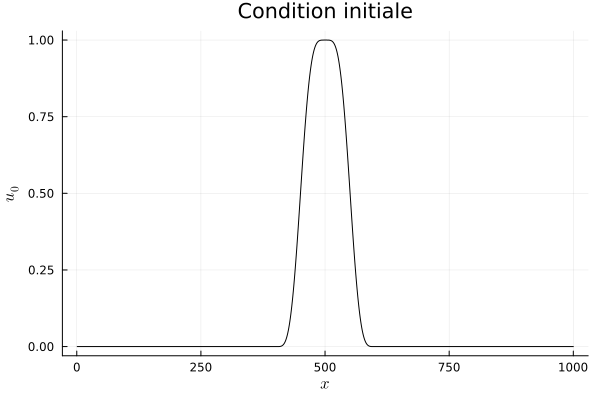

In [5]:
function u_init(X::AbstractVector, reg::Int, middle::Real, swidth::Real)

    # Parameters to localise the bump part
    xmin, xmax = min(X...), max(X...)
    width = swidth*(xmax - xmin)
    x_left, x_right = middle - width, middle + width

    # Array to store the output
    output = zero(X)

    ind_l = findall(x -> x > x_left && x <= middle, X)
    ind_r = findall(x -> x < x_right && x > middle, X)

    x_sl = (X[ind_l] .- x_left .- 0.5 * width) ./ (0.5 * width)
    x_sl_k = copy(x_sl)
    x_sl .= x_sl.^2
    x_sr = (X[ind_r] .- middle .- 0.5 * width) ./ (0.5 * width)
    x_sr_k = copy(x_sr)
    x_sr .= x_sr.^2

    cte = 0.0
    for k in 0:reg
        coeff = (-1)^k * binomial(reg, k) / (2 * k + 1)   # binomial is an inbuilt function in Julia
        output[ind_l] .+= coeff .* x_sl_k
        output[ind_r] .-= coeff .* x_sr_k
        cte += coeff
        x_sl_k .*= x_sl
        x_sr_k .*= x_sr
    end
    output[ind_l] .+= cte
    output[ind_r] .+= cte
    output ./= 2 * cte

    output
end

# Plot of an example of the initial condition
plot(u_init(collect(LinRange(0,1,1000)), 4, 0.5, 0.1), legend=:false, c=:black)
xlabel!(L"x")
ylabel!(L"u_0")
title!("Condition initiale")

Faisons une première simulation sans s'intéresser à choisir de bon paramètres pour voir ce la simulation donne. Nous nous plaçons sur le domaine $[x_{min}, x_{max}] = [-0.5, 0.5]$ qui a l'avantage d'être centré en zéro et dont la longueur, qui intervient dans certaines formules, est simplement 1. Même si ici on a mis des conditions aux bords périodiques, nous évitons d'aller "toucher les bords" pour ne pas faire intervenir d'évetuelles erreurs numériques qui proviendrait du traitement des solutions numériques au bord du domaine. En effet, la condition initiale étant à support compact, elle le restera si elle est solution de l'équation d'avection. Pour ce faire, nous choisirons un temps de simulation final $T_f$ de sorte que $T_f < \min(K, x_{max})/c$ (c est supposé positif et la bosse va se déplacer vers le bord droit du domaine). Il faudra d'ailleurs être un peu plus stricte sur cette condition car l'approximation numérique va subir une diffusion non voulue qui va aggrandir le compact de support de la solution. En effet, d'après le cours, dans le cas de l'équation d'advection, la solution va subir une diffusion de coeffcient : $D = Δt\left(\frac{1}{s_1}-\frac{1}{2} \right)(\lambda^2-c^2)$. Il faudrait donc enlever la longueur typique de diffusion qui est $\sqrt{DT_f}$, ce qui conduit à l'inégalité $cT_f + \sqrt{DT_f} < \min(K, x_{max}) $, dont la solution est $T_f < \left[\frac{\sqrt{4c\min(K, x_{max})+D}-\sqrt{D}}{2c}\right]^2$, mais nous ne l'utiliserons pas par simplicité.

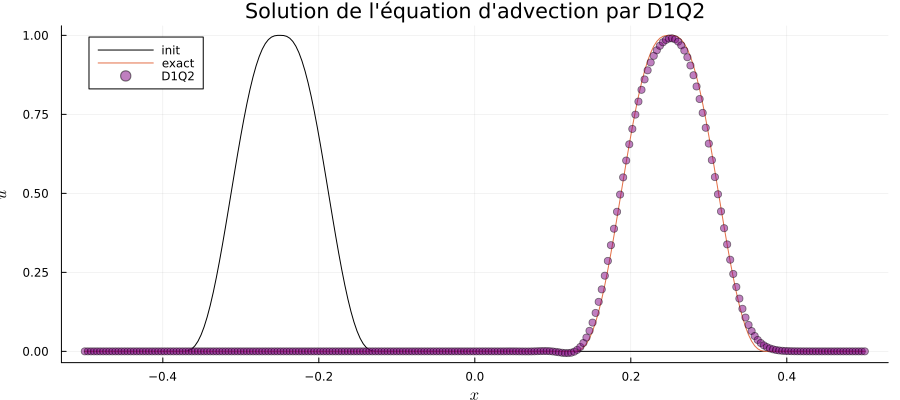

In [6]:
# Initial condition
center = -0.25
width = 0.125
u₀fun(x) = u_init(x, 2, center, width )   # regularity 2, center in -0.25 and with a witdh of 0.125 of the length of the domain

# Parameters
xmax = 0.5
xmin = -0.5
c = 0.5
Tf = 1.0   # the condition to not touch the edge of the domain is Tf < [0.5-(-0.25+0.125)]/0.5 = 1.25
Nₓ = 256
Nₜ = 256
s = 1.9
mesh = LinRange(xmin,xmax,Nₓ)

# Resolution
sol = solve(u₀fun, x -> advection(x, c); Nₜ = Nₜ, T = Tf, Nₓ = Nₓ, xmax = xmax, xmin = xmin, s = s)

# Exact solution
sol_exact = u₀fun(mesh .- c*Tf)

# Plot
plot(mesh, sol[1,:], label ="init", size = (900,400), c=:black)
plot!(mesh, sol_exact, label ="exact")
scatter!(mesh, sol[end,:], label = "D1Q2", markershape=:circle, ma = 0.5, mc = :purple)
xlabel!(L"x")
ylabel!(L"u")
title!("Solution de l'équation d'advection par D1Q2")

Affichons également une animation de la solution numérique.

┌ Info: Saved animation to C:\Users\theoz\AppData\Local\Temp\jl_G58B6JIt6J.gif
└ @ Plots C:\Users\theoz\.julia\packages\Plots\sxUvK\src\animation.jl:156


Plots.AnimatedGif("C:\\Users\\theoz\\AppData\\Local\\Temp\\jl_G58B6JIt6J.gif")
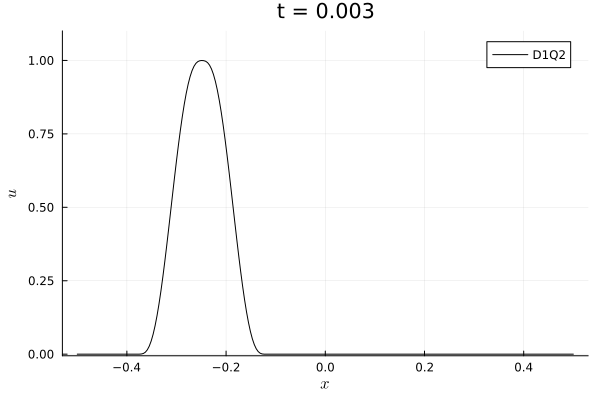

In [7]:
# Initial condition
center = -0.25
width = 0.125
u₀fun(x) = u_init(x, 2, center, width ) 

# Parameters
xmax = 0.5
xmin = -0.5
c = 0.5
Tf = 1.0  
Nₓ = 256
Nₜ = 256
s = 1.9
mesh = LinRange(xmin,xmax,Nₓ)

# Computation of the solutions
sol_exact = solve(u₀fun, x -> advection(x, c); Nₜ = Nₜ, T = Tf, Nₓ = Nₓ, xmax = xmax, xmin = xmin, s = s)

# Creation of the animation
animation(sol_exact; d = 10, fps = 30, Lmax = xmax, Lmin = xmin, T = Tf, label = "D1Q2")

Donnons à titre d'indication une analyse de la performance du code à l'aide de la bibliothèque 'BenchMarkTools.jl' :

In [8]:
@benchmark solve(u₀fun, x -> advection(x, c); Nₜ = Nₜ, T = Tf, Nₓ = Nₓ, xmax = xmax, xmin = xmin, s = s)

BenchmarkTools.Trial: 57 samples with 1 evaluation.
 Range (min … max):  65.305 ms … 125.591 ms  ┊ GC (min … max):  0.00% … 12.08%
 Time  (median):     80.669 ms               ┊ GC (median):    13.89%
 Time  (mean ± σ):   88.362 ms ±  15.459 ms  ┊ GC (mean ± σ):  12.20% ±  4.29%

              ▆█ ▂                                              
  ▄▁▁▁▄▄▁▁▄▅▁▄██▄█▅▁▁▄▅▄▄▁▄▁▁▁▁▄▄▄▄▅▁▅▁▁▅▁▁▁▁▁▄▁▄▁▄▄▁▁▁▁▁▄▄▁▁▅ ▁
  65.3 ms         Histogram: frequency by time          124 ms <

 Memory estimate: 62.31 MiB, allocs estimate: 1127841.

La méthode LBM D1Q2 permet de simuler toute équation de la forme 
$$ \partial_t u + \partial_x \varphi(u) =0 $$ 
tant que la condition initial $u_0$ et la fonction $φ : \mathbb{R} → \mathbb{R}$ est régulière. Nous avons vu en cours que à l'ordre 2 près en temps, cette méthode simule l'équation asymptotique 
$$ \partial_t u + \partial_x \varphi(u) =  Δt\left(\frac{1}{s_1}-\frac{1}{2} \right)\partial_{x} (\lambda^2-\varphi'(u)^2)\partial_xu + O(Δ t^2).$$
Il y a un troisième terme qui s'apparrente à un terme de diffusion. En particulier, il s'agit exactement d'un terme de diffusion pour l'équation d'advection car $\varphi'(u) = c$ avec un coefficient de diffusion égal à $Δt\left(\frac{1}{s_1}-\frac{1}{2} \right)(\lambda^2-c^2)$. Si le coefficient de diffusion est positif, ce terme supplémentaire va opérer à une régularisation de l'équation simulée avec donc un effet de diffusion non voulue. A l'inverse, si le coefficient de diffusion est négatif, la simulation ne pourra pas etre stable car le terme de diffusion va avoir l'effet inverse d'une régularisation avec une explosion de la simulation. Cela conduit donc à deux possibilités :
1. $λ≥|c|$ et $s_1 ≤ 2$,
2. $λ≤|c|$ et $s_1 ≥ 2$.

Nous allons nous plaçer dans la première configuration et allons étudier la deuxième dans la question suivante.
Traçons quelques simulations pour différentes valeurs de $\lambda$ et $s_1$ pour observer leurs influences.

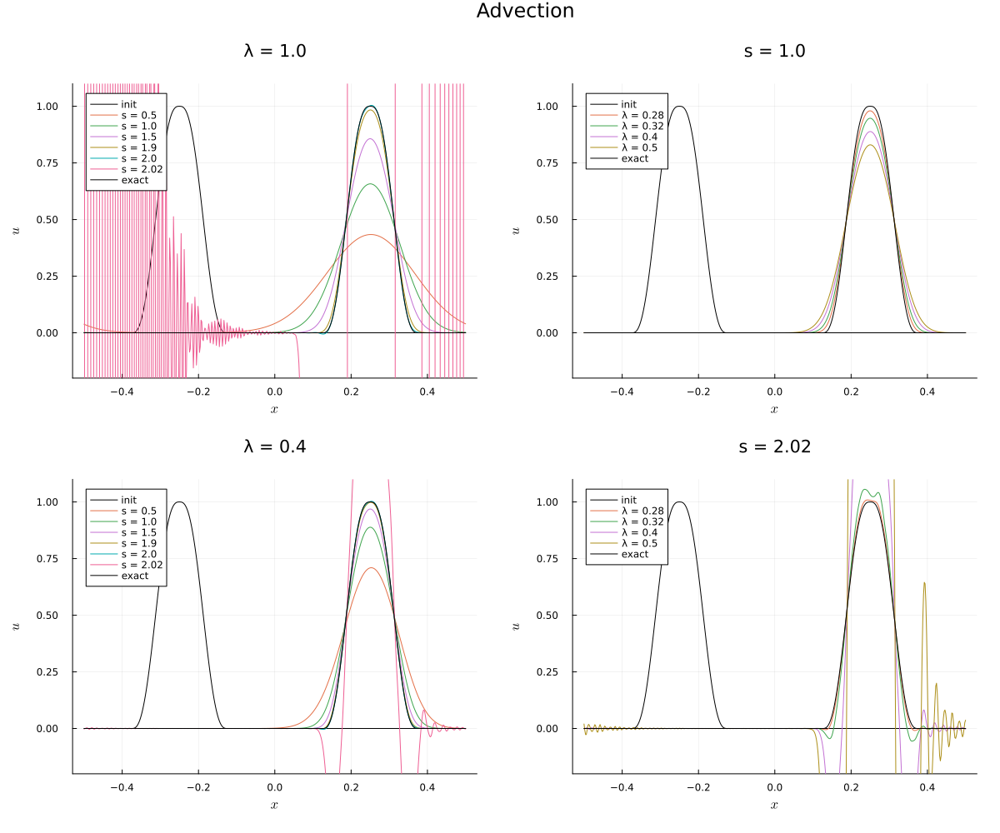

In [9]:
# initial condition
u₀fun(x) = u_init(x, 2, -0.25, 0.125)  # regularity 2, center in -0.25 and with a witdh of 0.125 of the length of the domain

# Fixed Parameters
xmax = 0.5
xmin = -0.5
c = 0.25
Tf = 2.0 
Nₓ = 500
mesh = LinRange(xmin,xmax,Nₓ)

# Parameters that will study the influence
# We compute the solution for {(λᵢ,s) | s ∈ Array_s} and for {(λ,sᵢ) | λ ∈ Array_λ} and for
λ₁ = 1.0
s₁ = 1.0
λ₂ = 0.4
s₂ = 2.02
Array_s = [0.5, 1.0, 1.5, 1.9, 2.0, 2.02]
Array_λ = [0.28, 0.32, 0.4, 0.5]

# Resolution
sol_s_λ₁ = [solve(u₀fun, x -> advection(x, c); Nₜ = Int(Tf *Nₓ*λ₁), T = Tf, Nₓ = Nₓ, xmax = xmax, xmin = xmin, s = s) for s ∈ Array_s]
sol_λ_s₁ = [solve(u₀fun, x -> advection(x, c); Nₜ = Int(Tf *Nₓ*λ), T = Tf, Nₓ = Nₓ, xmax = xmax, xmin = xmin, s = s₁) for λ ∈ Array_λ]
sol_s_λ₂ = [solve(u₀fun, x -> advection(x, c); Nₜ = Int(Tf *Nₓ*λ₂), T = Tf, Nₓ = Nₓ, xmax = xmax, xmin = xmin, s = s) for s ∈ Array_s]
sol_λ_s₂ = [solve(u₀fun, x -> advection(x, c); Nₜ = Int(Tf *Nₓ*λ), T = Tf, Nₓ = Nₓ, xmax = xmax, xmin = xmin, s = s₂) for λ ∈ Array_λ]

# Exact Solution
sol_exact = u_init(mesh .- c*Tf, 2, -0.25, 0.125)

# Plot of Solutions

plt_λ₁ = plot(mesh, u₀fun(mesh), label ="init", size = (900,400), c=:black, ylim = [-0.2, 1.1])
xlabel!(L"x")
ylabel!(L"u")
title!("λ = "*string(λ₁))
for i in eachindex(sol_s_λ₁)
    plot!(mesh, sol_s_λ₁[i][end,:], label = "s = "*string(Array_s[i]))
end
plot!(mesh, sol_exact, label ="exact", c=:black)

plt_λ₂ = plot(mesh, u₀fun(mesh), label ="init", size = (900,400), c=:black, ylim = [-0.2, 1.1])
xlabel!(L"x")
ylabel!(L"u")
title!("λ = "*string(λ₂))
for i in eachindex(sol_s_λ₂)
    plot!(mesh, sol_s_λ₂[i][end,:], label = "s = "*string(Array_s[i]))
end
plot!(mesh, sol_exact, label ="exact", c=:black)

plt_s₁ = plot(mesh, u₀fun(mesh), label ="init", size = (900,400), c=:black, ylim = [-0.2, 1.1])
xlabel!(L"x")
ylabel!(L"u")
title!("s = "*string(s₁))
for i in eachindex(sol_λ_s₁)
    plot!(mesh, sol_λ_s₁[i][end,:], label = "λ = "*string(Array_λ[i]))
end
plot!(mesh, sol_exact, label ="exact", c=:black)

plt_s₂ = plot(mesh, u₀fun(mesh), label ="init", size = (900,400), c=:black, ylim = [-0.2, 1.1])
xlabel!(L"x")
ylabel!(L"u")
title!("s = "*string(s₂))
for i in eachindex(sol_λ_s₂)
    plot!(mesh, sol_λ_s₂[i][end,:], label = "λ = "*string(Array_λ[i]))
end
plot!(mesh, sol_exact, label ="exact", c=:black)

plot(plt_λ₁,plt_s₁,plt_λ₂,plt_s₂, layout = (2,2), size = (1200,1000), color = :red, margin = 0.5Plots.cm, plot_title="Advection")

On observe les points suivants :
1) Pour λ = 1, on observe que plus $s$ est proche de $2$, plus la solution est correct. Cela est logique car à $λ$ fixé, le coefficient de diffusion diminue en restant positif lorsque $s$ se rapproche de 2 par valeurs inférieures. Par contre, une vlaeur de $s$ qui dépasse très légèrement 2 engendre une simulation très instable, ce qui est une nouvelle fois logique car le coefficient de diffusion est devenue négatif. Le point important est que cette instabilité explose même pour des valeurs très légèrement au-dessus de 2. On observe également de légers dépassements, par exemple la solution est par endroit négative, lorsque $s$ est proche de 2 par valeurs inférieures. Ces dépassements se situent principalement aux endroit de recollements de la solutions initiale construite, là où la régularité de lasolution  initiale est la plus faible.
2) Pour $s=1$,  on observe que plus $λ$ est proche de $c= 0.25$ par valeurs supérieurs, plus la solution est correct. Cela est logique car à $s$ fixé, le coefficient de diffusion diminue en restant positif lorsque $λ$ se rapproche de $c$ par valeurs supérieurs. 
3) Pour $λ=0.4$,  on observe que les instabilités sont nettement atténués pour $s$ proche de 2, que ce soit par valeurs inféireurs ou supérieurs, et que les solutions sont meilleures : le coefficient de diffusion est plus petit que dans le cas $λ = 1$.
2) Pour $s=2.02$,  on observe que si $λ$ est proche de $c$ en lui restant supérieur, on peut se rapprocher de solutions acceptables. A l'inverse que dans le cas $s = 1$, ici le coefficient de diffusion se rapproche de 0 mais par valeurs négatives. Cela se traduit que les solutions se rapprochent de la bonne solution mais avec de moins en moins d'instabilités et qui "arrivent par dessus" la solution exacte alors que dans le cas $s=1$ les solutions "arrivent par en-dessous".

### **Question 4**

Dans cette question on étudie le cas où $λ< |c|$. 


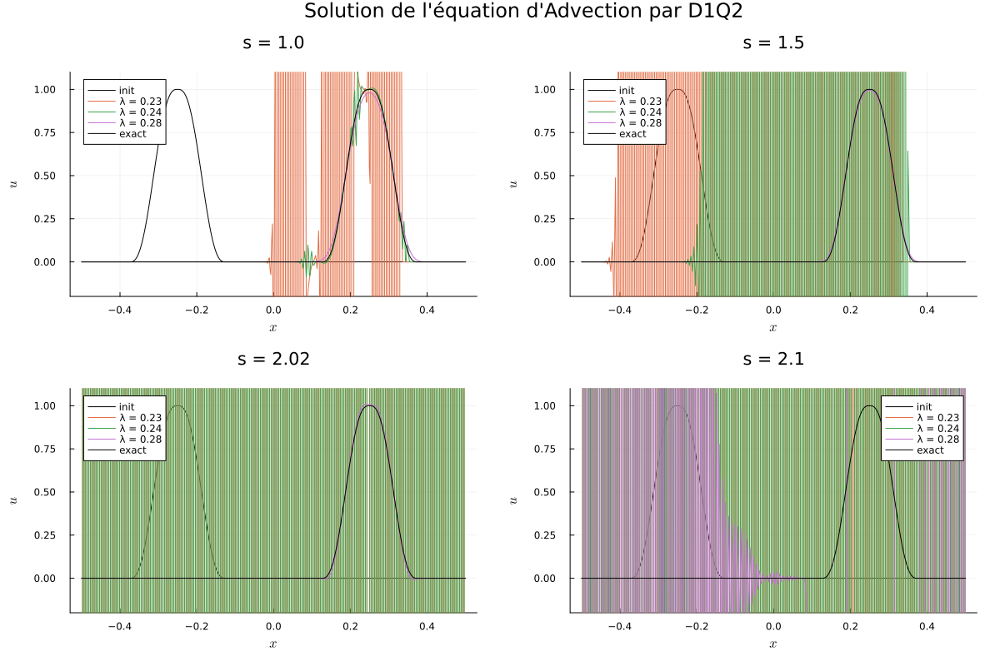

In [10]:
# Parameters
xmax = 0.5
xmin = -0.5
c = 0.25
Tf = 2.0 
Nₓ = 500
mesh = LinRange(xmin,xmax,Nₓ)

# Parameters
Array_λ = [0.23, 0.24,0.28]
Array_s = [1.0, 1.5, 2.02, 2.1]
set_Nₜ(λ) = Int(round(Nₓ*Tf*λ))

# initial condition
u₀fun(x) = u_init(x, 2, -0.25, 0.125)  # regularity 2, center in 0 and with a witdh of 0.1 of the length of the domain

# resolution
Array_sol = [[solve(u₀fun, x -> advection(x,c); Nₜ = set_Nₜ(λ), T = Tf, Nₓ = Nₓ, xmax = xmax, xmin = xmin, s = s) for λ ∈ Array_λ] for s in Array_s]

# Exact Solution
sol_exact = u₀fun(mesh .- c*Tf)

# plot
Array_plt = []

for (j,s) in zip(eachindex(Array_s),Array_s)
    plt = plot(mesh, u₀fun(mesh), label ="init", c=:black, ylim = [-0.2, 1.1])
    for (i,λ) ∈ zip(eachindex(Array_λ),Array_λ)
        plot!(mesh, Array_sol[j][i][end,:], label = "λ = "*string(λ))
    end
    plot!(mesh, sol_exact, label ="exact", c=:black)
    xlabel!(L"x")
    ylabel!(L"u")
    title!("s = "*string(s))
    push!(Array_plt, plt)
end
plot(Array_plt..., layout = (2,2),  plot_title = "Solution de l'équation d'Advection par D1Q2", size = (1200,800), margin = 0.5Plots.cm)

On remarque lorsque $λ = 0.28 > c = 0.25$, tout se passe comme dans la question précédente avec des solutions satisfaisantes lorsque $s<≤2.0$ et des instabilités lorsque $s>2.0$. Lorsque $λ < c$, il y a des instabilités quelques soit la valeur de $s$ et qui croissent très très vite lorsque $\lambda$ décroit légèrement. Pour $s > 2$, il y a toujours des instabilités, et même plus fortes car les solutions ne sont pmême pas affichés (présences de valeur NaN) alors que la diffusion est positive. Le problème de stabilité est donc d'origine purement numérique. Une explication serait que comme la vitesse $c$ est supérieure à la vitesse du réseau $\lambda$, toute la distribution à un endroit est transportée sur le voisin alors que sur cette même case arrive toute la distribution située sur l'autre voisin. Il se crée donc une alternance de points où il y a une explosion positive et de points où il y a une explosion négative.

### **Question 5**

On souhaite dans cette question étudier la vitesse de convergence de l'algorithme lorsque le pas d'espace $Δx$ tend vers 0. Cette convergence doit se faire à $\lambda$ fixé. En effet, dans le cas contraire; si supossons que l'on garde fixé le pas de temps $\Delta t$, alors $λ$ va tendre vers $0$ et le coefficient de diffusion de l'équation asymptotique va tendre vers une valeur finie non nulle : $-Δt\left(\frac{1}{s_1}-\frac{1}{2} \right)c^2$, qui plus est négatif ce qui est un problème. On peut aussi se rappeller la question précédente qui indique que $\lambda$ doit rester supérieur à $|c|$ et ne doit donc ne pas converger vers 0 avec le pas d'espace. 

L'erreur de convergence entre la solution exacte $u(T,⋅)$ à l'instant $T$ et la solution numérique $(u_{N,j})_{j\in\{0,\cdots ,  Nₓ\}}$ calculée pour cette même instant après N itérations ($T = NΔt$) s'écrit avec $||\cdot||_2$ la norme 2 de $\mathbb{R}^{N_x}$ :
$$Err(u, u_N)^2 = Δx||(u(T,x_j))_{j\in\{0,\cdots ,  Nₓ-1\}} - (u_{N,j})_{j\in\{0,\cdots ,  Nₓ-1\}} ||^2_2 = Δx \sum_{j=0}^{Nₓ-1} |u(T,x_j) - u_{N,j}|^2.$$



Commençons par tracer l'erreur pour différentes valeurs du paramètre $s$ : 

In [11]:
# Initial condition
u₀fun(x) = u_init(x, 4, -0.25, 0.125)  # regularity 2, center in -0.25 and with a witdh of 0.1 of the length of the domain

# Fixed parameters
xmax = 3.0
xmin = -3.0
c = 0.5
Tf = 1.0
λ = 0.6

# Different value of s
Array_s = [0.5, 1.0, 1.5, 2.0]

# Variation of the parameter $Δx$ : 
pNₓ= range(3,11)
base = 2.0
ArrayNₓ = Int.(round.( base  .^ pNₓ))

# Resolution
Arraysol = [[solve(u₀fun, x -> advection(x, c); T = Tf, Nₓ = Nₓ, xmax = xmax, xmin = xmin, s = s, λ = λ) for Nₓ ∈ ArrayNₓ] for s ∈ Array_s]
real_T = [[sol[2] for sol ∈ Arraysol[i]] for i ∈ eachindex(Arraysol)]

# Exact solution
sol_exact = [[u₀fun(LinRange(xmin,xmax,Nₓ) .- c* T) for (Nₓ,T) ∈ zip(ArrayNₓ, real_T[i])] for i ∈ eachindex(real_T)]

# Computation of the error
err = [[sqrt((xmax-xmin)/(ArrayNₓ[j]-1))*norm(sol_exact[i][j][1:end-1] .- Arraysol[i][j][1][end,1:end-1]) for j ∈ eachindex(ArrayNₓ)] for i ∈ eachindex(Arraysol)]

4-element Vector{Vector{Float64}}:
 [0.13366171457896583, 0.18109837326418016, 0.17500524429839617, 0.13240875559719198, 0.09857940967675202, 0.061675224950973696, 0.034990046572130874, 0.019003223238028794, 0.009972318819157668]
 [0.13366171457896583, 0.18109837326418016, 0.14480210191173723, 0.08101490356388008, 0.04793521753659088, 0.02579651890104546, 0.013213993235734186, 0.006756488564967297, 0.0034339638619990264]
 [0.13366171457896583, 0.18109837326418016, 0.12863082989228805, 0.04844004593740334, 0.02127445812834305, 0.00984396477692164, 0.004697800574763906, 0.002323689728142064, 0.0011623970890523394]
 [0.13366171457896583, 0.18109837326418016, 0.14333168435593024, 0.03253658310289571, 0.009047493823914133, 0.001925857365673529, 0.0005144505695972831, 0.00011319852846110032, 3.1916603647687606e-5]

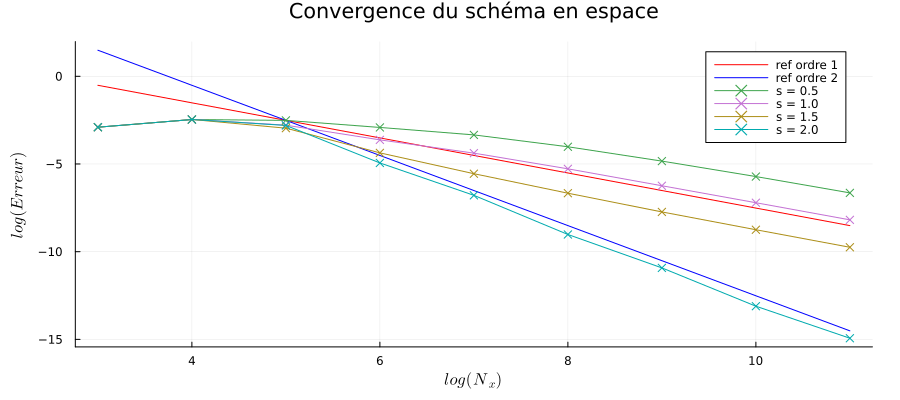

In [12]:
# Function to plot straight curve
courbe(pente::Real, x::Real, y::Real, span::AbstractVector) = (-pente*x + y) .+ pente .* span

# Plot
plot(margin = 0.5Plots.cm, size = (900,400))
plot!(pNₓ, courbe(-1, 5, log(err[1][3])./log(base), pNₓ) , label ="ref ordre 1", size = (900,400), c=:red)
plot!(pNₓ, courbe(-2, 5, log(err[1][3])./log(base), pNₓ) , label ="ref ordre 2", size = (900,400), c=:blue)
for (e,s) ∈ zip(err, Array_s) 
    plot!(pNₓ, log.(e[eachindex(pNₓ)]) ./ log(base), label ="s = "*string(s), shape =:x)
end
xlabel!(L"log(N_x)")
ylabel!(L"log(Erreur)")
title!("Convergence du schéma en espace")

On observe que l'on a bien un ordre de convergence 1 en espace à $λ$ fixé lorsque $s<2$ et un ordre 2 pour $s = 2$.

Etudions maintenant l'influencede la régularité de la condition initiale dans la convergence spatiale du schéma.

In [13]:
# Initial condition
u₀fun(x, r) = u_init(x, r, -0.25, 0.125)

# Fixed parameters
xmax = 3.0
xmin = -3.0
c = 0.5
Tf = 1.0
λ = 0.6

# Different value of s
Array_s = [1.0, 2.0]

# Different value of regularity
Array_reg = [0, 1, 2, 3, 4]

# Variation of the parameter $Δx$ : 
pNₓ= range(3,9)
base = 2.0
ArrayNₓ = Int.(round.( base  .^ pNₓ))

# Resolution
Arraysol = [[[solve(x -> u₀fun(x, reg), x -> advection(x, c); T = Tf, Nₓ = Nₓ, xmax = xmax, xmin = xmin, s = s, λ = λ) for Nₓ ∈ ArrayNₓ] for reg ∈ Array_reg ] for s ∈ Array_s]
real_T = [[[sol[2] for sol ∈ Arraysol[i][r]] for r ∈ eachindex(Array_reg)] for i ∈ eachindex(Arraysol)]

# Exact solution
sol_exact = [[[u₀fun(LinRange(xmin,xmax,Nₓ) .- c* T, Array_reg[r]) for (Nₓ,T) ∈ zip(ArrayNₓ, real_T[i][r])] for r ∈ eachindex(Array_reg)] for i ∈ eachindex(real_T)]

# Computation of the error
err = [[[sqrt((xmax-xmin)/(ArrayNₓ[j]-1))*norm(sol_exact[i][r][j][1:end-1] .- Arraysol[i][r][j][1][end,1:end-1]) for j ∈ eachindex(ArrayNₓ)] for r ∈ eachindex(Array_reg)] for i ∈ eachindex(Arraysol)]

2-element Vector{Vector{Vector{Float64}}}:
 [[0.255592876248425, 0.07825251938515076, 0.07853533040095846, 0.05619202624652734, 0.03291092825779624, 0.0182039787232201, 0.010799597965572602], [0.20466860727378522, 0.12090137876750197, 0.1022525842785968, 0.05385213066357163, 0.030199236328920534, 0.015533927896602495, 0.007761402527144205], [0.16910316310852225, 0.14944775871569588, 0.11588206076784774, 0.06308696474527957, 0.035898841058267066, 0.018673832879838283, 0.00938007858199191], [0.14712683873574808, 0.16801786159925583, 0.1298770216167584, 0.07246471145957743, 0.042150149024939736, 0.02233532158777983, 0.01133611012741355], [0.13366171457896583, 0.18109837326418016, 0.14480210191173723, 0.08101490356388008, 0.04793521753659088, 0.02579651890104546, 0.013213993235734186]]
 [[0.255592876248425, 0.07825251938515076, 0.06036827302684675, 0.036345134945671154, 0.014842708978135463, 0.007096308787121134, 0.003492332116356203], [0.20466860727378522, 0.12090137876750197, 0.073920080

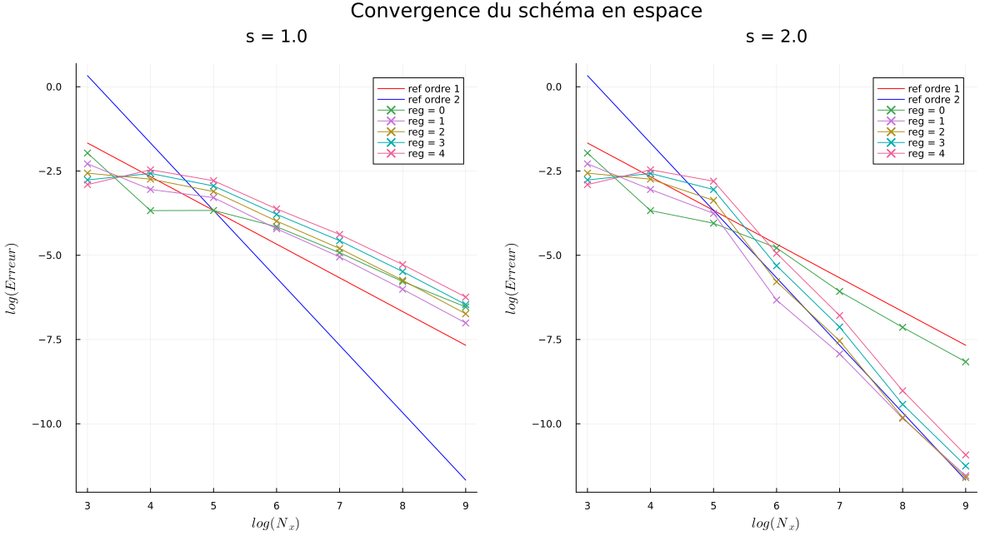

In [14]:
# Function to plot straight curve
courbe(pente::Real, x::Real, y::Real, span::AbstractVector) = (-pente*x + y) .+ pente .* span

# Plot
array_plt = []
for i ∈ eachindex(Array_s)
    plt = plot(margin = 0.5Plots.cm, size = (900,400))
    plot!(plt, pNₓ, courbe(-1, 5, log(err[1][1][3])./log(base), pNₓ) , label ="ref ordre 1", size = (900,400), c=:red)
    plot!(plt, pNₓ, courbe(-2, 5, log(err[1][1][3])./log(base), pNₓ) , label ="ref ordre 2", size = (900,400), c=:blue)
    for (e, reg) ∈ zip(err[i], Array_reg)
        plot!(plt, pNₓ, log.(e[eachindex(pNₓ)]) ./ log(base), label ="reg = "*string(reg), shape =:x)
    end
    xlabel!(L"log(N_x)")
    ylabel!(L"log(Erreur)")
    title!("s = "*string(Array_s[i]))
    push!(array_plt, plt)
end

plot(array_plt..., layout = (1,2),  plot_title = "Convergence du schéma en espace", size = (1200,650), margin = 0.5Plots.cm)

On remarque que dès que la condition initiale est  $C^1$, les ordres de convergence sont comme dans la figure précédente, mais dès que la condition initiale est seulement continue, il y a une perte de convergence avec un ordre 1 lorsque $s=2$ et inférieur à 1 lorsque $s<2$.

In [15]:
(log(err[1][1][7]) - log(err[1][1][4]))/(log(ArrayNₓ[7]) - log(ArrayNₓ[4]))

-0.7931292724581315

L'ordre de convergence est d'environ 0.79.

Etudions enfin l'influcence du paramètre $λ$ dans l'ordre de convergence.

In [16]:
# Initial condition
u₀fun(x) = u_init(x, 4, -0.25, 0.125)

# Fixed parameters
xmax = 3.0
xmin = -3.0
c = 0.5
Tf = 1.0

# Different value of s
Array_s = [1.0, 2.0]

# Different value of λ
Array_λ = [0.5, 0.75, 1.0, 2.0]

# Variation of the parameter $Δx$ : 
pNₓ= range(3,9)
base = 2.0
ArrayNₓ = Int.(round.( base  .^ pNₓ))

# Resolution
Arraysol = [[[solve(u₀fun, x -> advection(x, c); T = Tf, Nₓ = Nₓ, xmax = xmax, xmin = xmin, s = s, λ = λ) for Nₓ ∈ ArrayNₓ] for λ ∈ Array_λ ] for s ∈ Array_s]
real_T = [[[sol[2] for sol ∈ Arraysol[i][l]] for l ∈ eachindex(Array_λ)] for i ∈ eachindex(Arraysol)]

# Exact solution
sol_exact = [[[u₀fun(LinRange(xmin,xmax,Nₓ) .- c* T) for (Nₓ,T) ∈ zip(ArrayNₓ, real_T[i][l])] for l ∈ eachindex(Array_λ)] for i ∈ eachindex(real_T)]

# Computation of the error
err = [[[sqrt((xmax-xmin)/(ArrayNₓ[j]-1))*norm(sol_exact[i][l][j][1:end-1] .- Arraysol[i][l][j][1][end,1:end-1]) for j ∈ eachindex(ArrayNₓ)] for l ∈ eachindex(Array_λ)] for i ∈ eachindex(Arraysol)]

2-element Vector{Vector{Vector{Float64}}}:
 [[2.1508007210882493e-16, 5.715222817774257e-16, 7.22051587001101e-16, 7.282258038966389e-16, 7.276704751313931e-16, 7.199210368308247e-16, 6.797286242127119e-16], [0.2339843387613072, 0.3711115769715304, 0.26059407223582387, 0.1549992911969733, 0.09188000960407296, 0.05233825580366464, 0.02848118830748098], [0.2554566613251788, 0.4652351293066371, 0.33615045966710005, 0.2172466432567571, 0.1389622389096759, 0.08285661811490855, 0.047519305777975925], [0.9611680172805771, 0.5333838913432934, 0.47286698704834235, 0.36353232342101033, 0.25064332138040346, 0.1616011910568634, 0.09849526146648649]]
 [[2.1508007210882493e-16, 5.715222817774257e-16, 7.22051587001101e-16, 7.282258038966389e-16, 7.276704751313931e-16, 7.199210368308247e-16, 6.797286242127119e-16], [0.2339843387613072, 0.47312680323358186, 0.13334373859558996, 0.048351946988148625, 0.013518460966570129, 0.003353362782308062, 0.0008313814014258749], [0.2554566613251788, 0.4782595717299

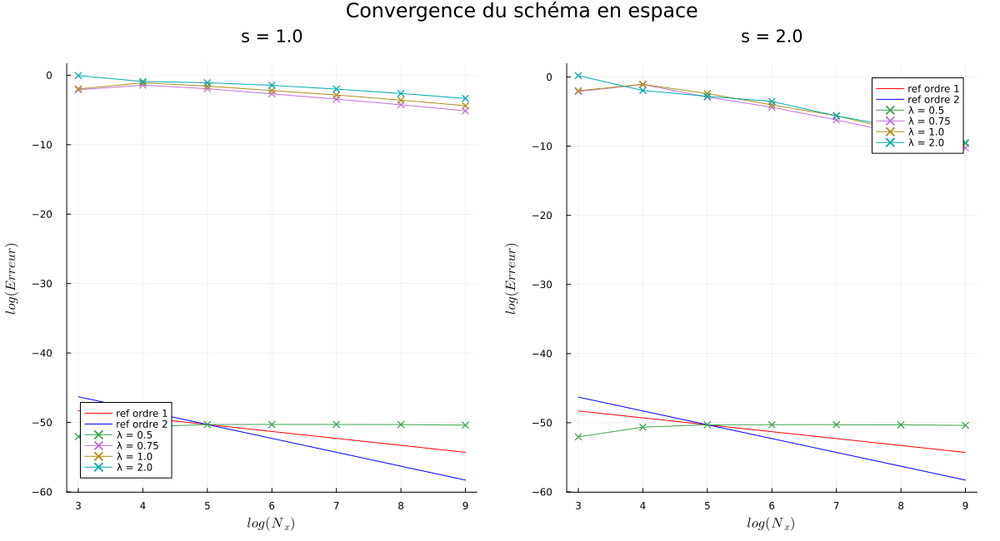

In [17]:
# Function to plot straight curve
courbe(pente::Real, x::Real, y::Real, span::AbstractVector) = (-pente*x + y) .+ pente .* span

# Plot
array_plt = []
for i ∈ eachindex(Array_s)
    plt = plot(margin = 0.5Plots.cm, size = (900,400))
    plot!(plt, pNₓ, courbe(-1, 5, log(err[1][1][3])./log(base), pNₓ) , label ="ref ordre 1", size = (900,400), c=:red)
    plot!(plt, pNₓ, courbe(-2, 5, log(err[1][1][3])./log(base), pNₓ) , label ="ref ordre 2", size = (900,400), c=:blue)
    for (e, λ) ∈ zip(err[i], Array_λ)
        plot!(plt, pNₓ, log.(e[eachindex(pNₓ)]) ./ log(base), label ="λ = "*string(λ), shape =:x)
    end
    xlabel!(L"log(N_x)")
    ylabel!(L"log(Erreur)")
    title!("s = "*string(Array_s[i]))
    push!(array_plt, plt)
end

plot(array_plt..., layout = (1,2),  plot_title = "Convergence du schéma en espace", size = (1200,650), margin = 0.5Plots.cm)

On ne remarque pas de changement de comportement avec la valeur λ, excepté pour $λ= 0.5 = c$. Pour cetteavleur , il ne semblerait qu'il n'y ait pas de convergence mais que l'erreur reste constante à une valeur très inférieure en ordre de grandeur que pour les autres valeurs de $\lambda$ de sorte que tant que $Δx$ n'a pas atteint une valeur très petite, la solution proposé par $\lambda = 0.5$ est meilleure. 

## **Exercice 2** : Equation de Burgers

Dans cette partie, on s'intéresse à l'équation de Burgers : 
$$ \partial_t u + \frac{1}{2}\partial_x u^2 =0.$$

In [18]:
# Burgers
burgers(u::Real) = 0.5*u^2

burgers (generic function with 1 method)

### **Question 1**

Il faut que $m_1^{eq} = \varphi(m_0) = \frac{m_0^2}{2}$ pour que le schéma soit consistant d'après le cours.

### **Question 2**

Voici le scipt permettant de calculer tracer la solution exacte proposée à différents instants. 

In [19]:
function solution_adimensionnee(X::AbstractVector, t::Real)
    #=
    A normalized hat solution of the Burgers equation starting from the following initial condition
                                /\                      y=1
                               /  \
                              /    \
           __________________/      \__________________ y=0
                        x=  -1  0    1
    computed on the domain defined by X 
    =#

    Y = zeros(size(X))
    if t < 0
        return y
    elseif t < 1
        xᵢ = t
        indr = findall(x -> x ≥ t && x < 1, X)
        Y[indr] = 1 .- 1/(1-t) .* (X[indr] .- t)
    else
        xᵢ = 2*sqrt(.5*(1+t))- 1
    end
    indl = findall(x -> x ≥ -1 && x ≤ xᵢ, X)
    Y[indl] = 1/(1+t).* (1 .+ X[indl])
    Y
end

function solution(x::AbstractVector, t::Real; ymax::Real = 1, middle::Real, width::Real)
    # INPUTS
    #   - x         : Mesh of the domain
    #   - t         : Time
    #   - ymax      : Height of the intitial condition
    #   - middle    : Center of the initial condition
    #   - width     : Widhth of the initial condition

    # OUTPUTS
    #   -   Hat solution of the Burgers equation with a height of ymax at instant t on the domain defined by the mesh x
    ymax*solution_adimensionnee(1/width*(x .- middle), ymax/width*t)
end

solution (generic function with 1 method)

Affichons maintenant la solution à différents instants $\left(t∈\{0.0, 0.05, 0.1, 0.125, 0.15, 0.2, 0.25, 0.5 \}\right)$ sur un maillage très fin $Nₓ = 10^6$ de sorte à pouvoir voir au mieux la discontinuité sur le domaine $[x_{min} = -0.5, x_{max} = 0.5]$. On prendra une condition initiale d'amplitude 1, de centre $-0.25$ et de largeur $0.125$.

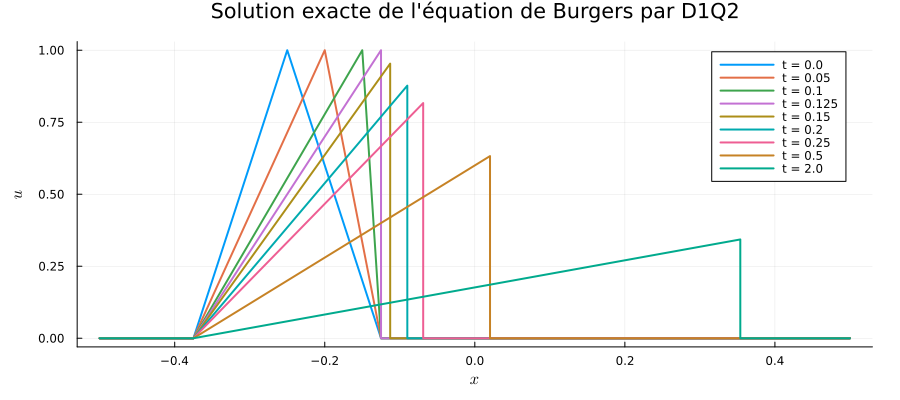

In [20]:
# Parameters
middle = -0.25
width = 0.125
xmin = -0.5
xmax = 0.5
Nₓ   = 100000
mesh = LinRange(xmin, xmax, Nₓ)
T    = 0.5
time = [0.0, 0.05, 0.1, 0.125, 0.15, 0.2, 0.25, 0.5, 2.0]

# Computation of the solutions
sol_exact = reduce(hcat,[solution(mesh, t; middle = middle, width = width) for t in time])'

# Plot
plot(size = (900,400), margin = 0.5Plots.cm)
for (i,t) ∈ zip(eachindex(time), time)
    plot!(mesh, sol_exact[i,:], label = "t = "*string(t), lw = 2)
end
xlabel!(L"x")
ylabel!(L"u")
title!("Solution exacte de l'équation de Burgers par D1Q2")

En utilisant la fonction animation présentée au début du document, on peut voir une animation de la solution au cours du temps avec une discrétsiation temporelle fine (de 0 à 0.5 avec 1000 points) : 

┌ Info: Saved animation to C:\Users\theoz\AppData\Local\Temp\jl_YbsrwHIpIZ.gif
└ @ Plots C:\Users\theoz\.julia\packages\Plots\sxUvK\src\animation.jl:156


Plots.AnimatedGif("C:\\Users\\theoz\\AppData\\Local\\Temp\\jl_YbsrwHIpIZ.gif")
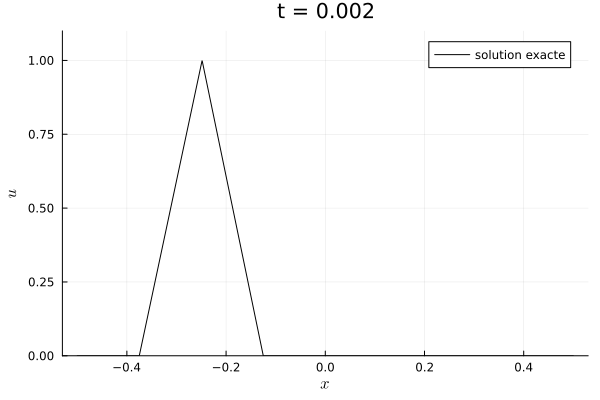

In [21]:
# Parameters
xmin = -0.5
xmax = 0.5
Nₓ   = 10000
mesh = LinRange(xmin, xmax, Nₓ)
T    = 0.5
Nₜ    = 1000
time = LinRange(0, T, Nₜ) 

# Computation of the solutions
sol_exact = reduce(hcat,[solution(mesh, t; middle = middle, width = width) for t in time])'

# Creation of the animation
animation(sol_exact; d = 10, fps = 30, Lmax = xmax, Lmin = xmin, T = T, label = "solution exacte")

On peut voir sur l'animation et appuyé par le graphique précédent que l'instant de discontinuité ets atteint pour $t=0.125$. Il est possible de le trouver numérique si l'on s'apperçoit que l'instant de discontinuité est le dernier instant où la solution conserve la même amplitude que la condition initiale. On regarde donc le premier instant où la solution n'a pas une amplitude de 1.  On peut procéder par dichotomie, avec la connaissance préalable, au vus des graphiques précédents que ce premier instant se situe dans l'intervalle de temps $[0,0.5]$.

Numériquement, on fait attention au fait qu'il ne faut pas vraiment regarder un tel premier instant. En effet, l'extremum n'est atteint qu'en un seul point qui pourrait ne pas appartenir à notre maillage. Pour notre condition initiale, l'erreur est d'au plus $2/width * Δx= 2/(width * Nₓ) =  1.6.10^{-4}$. Au cours du temps, la pente à gauche du pic sera de moins en moins pentu, ce qui garantit qu'au cours du temps l'erreur sur le calcule de l'amplitude de la solution sera d'au plus $ 1.6.10^{-4}$.

In [22]:
# Parameters
middle = -0.25
width = 0.125
xmin = -0.5
xmax = 0.5
Nₓ   = 100000
mesh = LinRange(xmin, xmax, Nₓ)

# Method to compute the time of the discontinuity
tg = 0.0
td = 0.5
tc = 0.0
while abs(td - tg) > 1e-5
    tc = (tg+td)/2
    sol = solution(mesh, tc; middle = middle, width = width)
    if abs(max(sol...) - 1.0) < 1.6e-4  
        tg = tc
    else
        td = tc
    end
end

print("Le point de discontinuité est atteint en t = "*string(tc))

Le point de discontinuité est atteint en t = 0.12506866455078125

On trouve que le point de discontinuité est atteint en $t=0.125$ à trois chiffres après la virgule près, ce qui est le résultat exact. 

### **Question 3**

Voir ci-dessus pour le code. Les conditions aux bords sont toujours périodiques

### **Question 4**

Affichons une première simulation pour tester le code sur l'équation de Burgers avec la condition initiale donnée. Les paramètres de la simulation sont explicitement donné dans le script qui suit. 

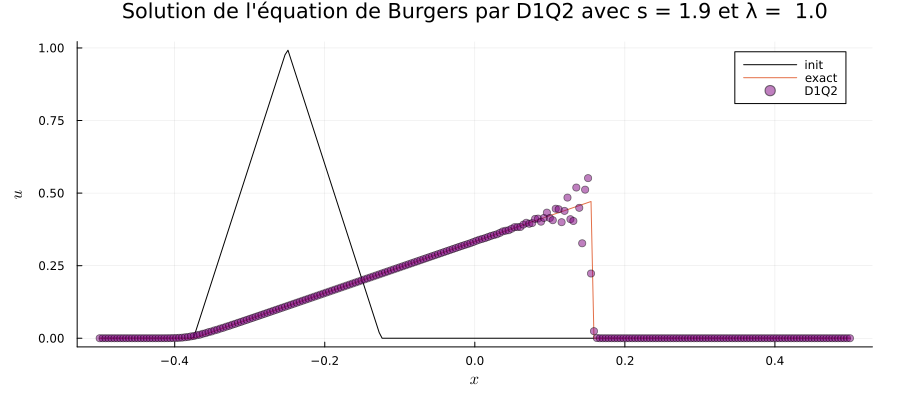

In [23]:
# Parameters
middle = -0.25
width = 0.125
xmax = 0.5
xmin = -0.5
Tf = 1.0  
Nₓ = 256
Nₜ = 256
s = 1.9
mesh = LinRange(xmin,xmax,Nₓ)
λ = Nₜ*(xmax-xmin)/(Nₓ*Tf)

# Initial condition
u₀fun(x) = solution(x, 0; middle = middle, width = width) 

# Resolution
sol = solve(u₀fun, x -> burgers(x); Nₜ = Nₜ, T = Tf, Nₓ = Nₓ, xmax = xmax, xmin = xmin, s = s)

# Exact solution
sol_exact = solution(mesh, Tf; middle = middle, width = width)

# Plot
plot(mesh, sol[1,:], label ="init", size = (900,400), c=:black, margin = 0.5Plots.cm)
plot!(mesh, sol_exact, label ="exact")
scatter!(mesh, sol[end,:], label = "D1Q2", markershape=:circle, ma = 0.5, mc = :purple)
xlabel!(L"x")
ylabel!(L"u")
title!("Solution de l'équation de Burgers par D1Q2 avec s = "*string(s)*" et λ =  "*string(λ))

On remarque que la solution est assez bonne en dehors de la discontinuité. Au niveau de la discontinuité, il y a quelques oscillations du coté gauche de la discontinuité, i.e du côté où la solution n'est pas nulle. Etudions maintenant l'influence des paramètres $\lambda$ et $s$ plus en détails :

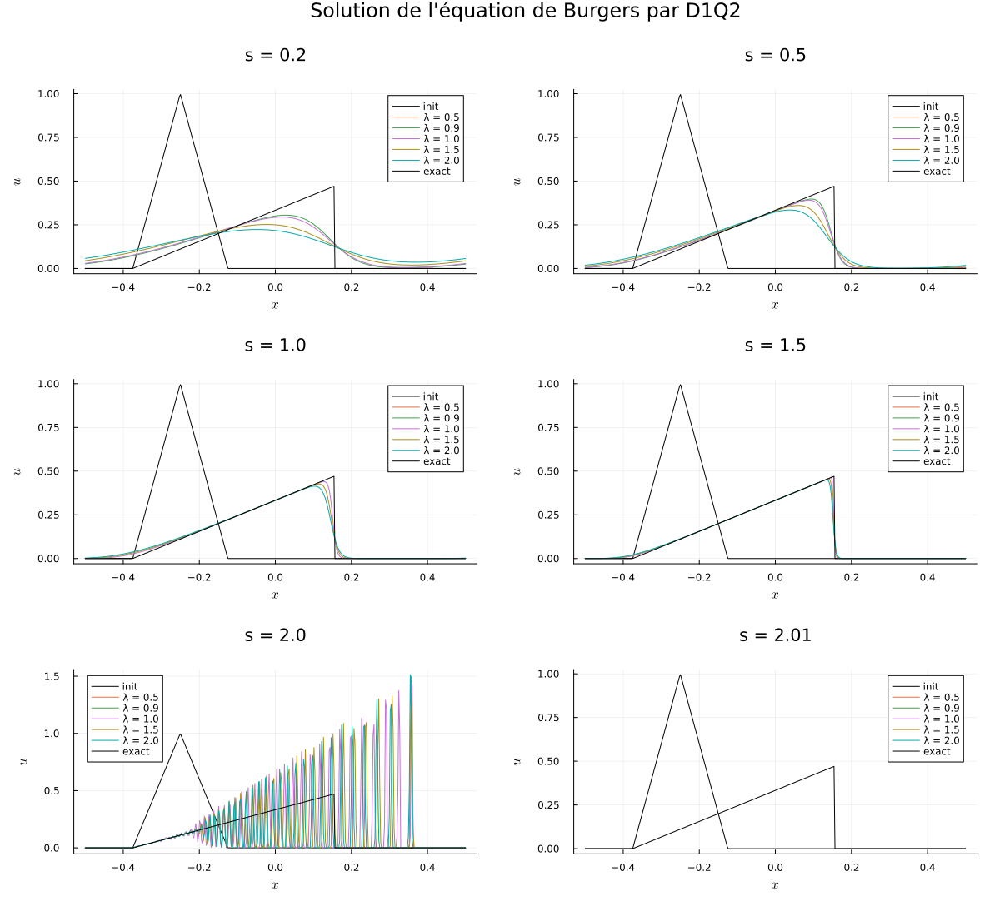

In [24]:
# Parameters
middle = -0.25
width = 0.125
xmax = 0.5
xmin = -0.5
Tf = 1.0  
Nₓ = 400
mesh = LinRange(xmin,xmax,Nₓ)
Array_λ = [0.5, 0.9, 1.0, 1.5, 2.0]
Array_s = [0.2, 0.5, 1.0, 1.5, 2.0, 2.01]
set_Nₜ(λ) = Int(round(Nₓ*Tf*λ))

# initial condition
u₀fun(x) = solution(x, 0; middle = middle, width = width) 

# resolution
Array_sol = [[solve(u₀fun, x -> burgers(x); Nₜ = set_Nₜ(λ), T = Tf, Nₓ = Nₓ, xmax = xmax, xmin = xmin, s = s) for λ ∈ Array_λ] for s in Array_s]

# exact solution
sol_exact = solution(mesh, Tf; middle = middle, width = width)

# plot
Array_plt = []

for (j,s) in zip(eachindex(Array_s),Array_s)
    plt = plot(mesh, u₀fun(mesh), label ="init", c=:black)
    for (i,λ) ∈ zip(eachindex(Array_λ),Array_λ)
        plot!(mesh, Array_sol[j][i][end,:], label = "λ = "*string(λ))
    end
    plot!(mesh, sol_exact, label ="exact", c=:black)
    xlabel!(L"x")
    ylabel!(L"u")
    title!("s = "*string(s))
    push!(Array_plt, plt)
end
plot(Array_plt..., layout = (3,2),  plot_title = "Solution de l'équation de Burgers par D1Q2", size = (1200,1100), margin = 0.5Plots.cm)

On peut faire les remarques suivantes :
1. Le code n'a pas affiché les solutions corespondant à $λ = 0.5$, la simulation est instable pour cette valeur mais est stable pour des valeurs de $λ$ assez grandes en notant qu'à partir de $λ = 0.9$, les simulations tournent correctement.
2. Plus $s$ est proche de 2 (sans atteindre 2), plus les simulations sont bonnes sans aucun dépassement ni d'oscillation parasyte. Mais pour $s = 2$, la simulation est très instable avec beaucoup d'osccilations. Contrairement au cas de l'advection, la valeur $s=2$ ne peut être prise et il sera donc improbable d'atteindre un ordre 2 de convergence. Pour des petites valeurs de $s$, on remarque que les solutions ont subi une forte réduction de leur amplitude : la diffusion a été trop forte.
3. Dès $s = 2.01$ la simulation est complètement instable quelque soit la valeur de $\lambda$ : les instabilités sont donc beaucoup plus fortes que dans le cas de l'advection.
4. On remarque que à $s∈]0,2[$ fixé, la meilleure solution est obtenue pour $λ = 0.9$, c'est à dire la plus petite valeur de $\lambda$ parmi celles des solutions stables.

Regardons plus en détails autour de la valeur de $λ = 0.9$ pour une valeur de $\lambda$ optimale. Fixons nous pour cela $s = 1.0$.

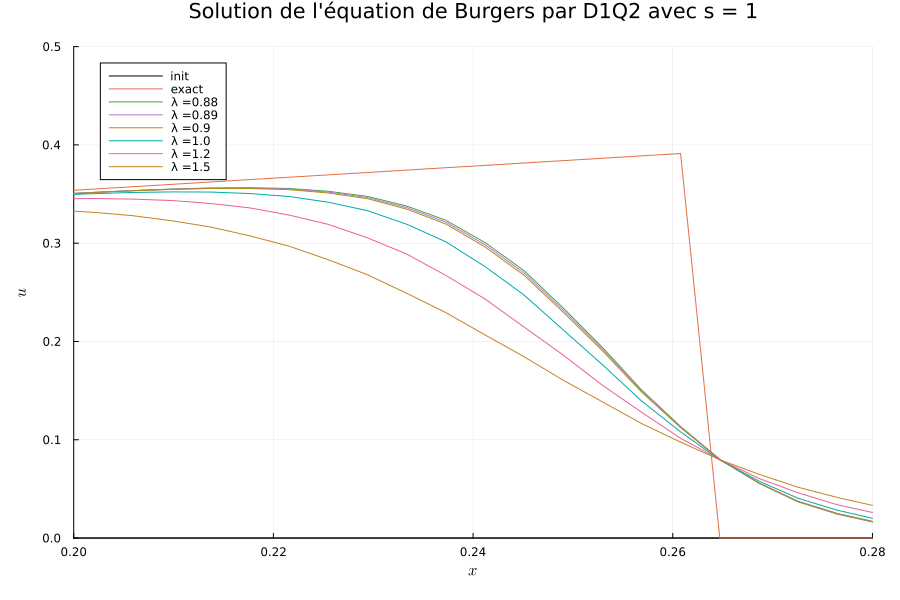

In [25]:
# Parameters
middle = -0.25
width = 0.125
xmax = 0.5
xmin = -0.5
Tf = 1.5  
Nₓ = 256
s = 1.0
mesh = LinRange(xmin,xmax,Nₓ)
Array_λ = [0.88, 0.89, 0.9, 1.0, 1.2, 1.5]
set_Nₜ(λ) = Int(round(Nₓ*Tf*λ))

# Initial condition
u₀fun(x) = solution(x, 0; middle = middle, width = width) 

# Resolution
Array_sol = [solve(u₀fun, x -> burgers(x); Nₜ = set_Nₜ(λ), T = Tf, Nₓ = Nₓ, xmax = xmax, xmin = xmin, s = s) for λ ∈ Array_λ]

# Exact solution
sol_exact = solution(mesh, Tf; middle = middle, width = width)

# Plot
plot(mesh, u₀fun(mesh), label ="init", size = (900,600), c=:black, margin = 0.5Plots.cm, xlim = [0.2,0.28], ylim = [0.0, 0.5])
plot!(mesh, sol_exact, label ="exact")
for (i,λ) ∈ zip(eachindex(Array_λ), Array_λ)
    plot!(mesh, Array_sol[i][end,:], label = "λ ="*string(λ))
end
xlabel!(L"x")
ylabel!(L"u")
title!("Solution de l'équation de Burgers par D1Q2 avec s = 1")

On remarque que la valeur limite pour $\lambda$ est aux alentours de 0.88 (la simulation est instable pour $λ = 0.87$) et la solution numérique correspondante à cette valeur est la meilleure. On remarque que la solution ne semble pas converger ou que très lentement vers la solution exacte lorsque $λ$ se rapproche de la valeur limite.

On regarde maintenant plus en détails l'évolution des perturbations au cours du temps dans le cas $s=2$ :

┌ Info: Saved animation to C:\Users\theoz\AppData\Local\Temp\jl_ItGjY3WdyD.gif
└ @ Plots C:\Users\theoz\.julia\packages\Plots\sxUvK\src\animation.jl:156


Plots.AnimatedGif("C:\\Users\\theoz\\AppData\\Local\\Temp\\jl_ItGjY3WdyD.gif")
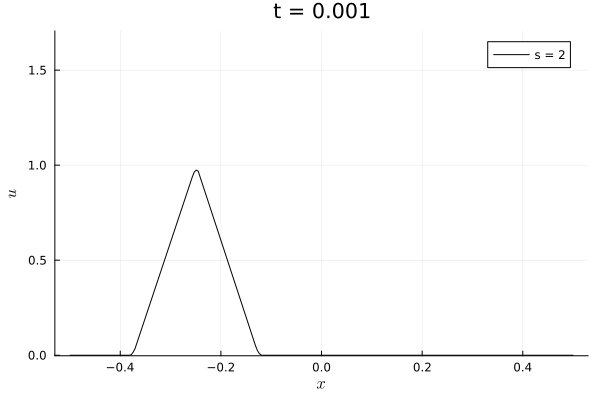

In [32]:
# Parameters
middle = -0.25
width = 0.125
xmax = 0.5
xmin = -0.5
Tf = 0.3 
Nₓ = 256
Nₜ = 256
s = 2.0
mesh = LinRange(xmin,xmax,Nₓ)

# Initial condition
u₀fun(x) = solution(x, 0; middle = middle, width = width) 

# Computation of the solutions
sol = solve(u₀fun, x -> burgers(x); Nₜ = Nₜ, T = Tf, Nₓ = Nₓ, xmax = xmax, xmin = xmin, s = s)

# Creation of the animation
animation(sol; d = 10, fps = 30, Lmax = xmax, Lmin = xmin, T = Tf, label = "s = 2")

On remarque que les instabilités se développent à partir du premier instant de discontinuité.



### **Question 5**

Comme déjà remarqué, la solution numérique n'est pas pertinente quelque que soit la valeur de $λ$ : pour des valeurs de $λ<0.88$, la solution est instable. Au vue de l'analyse faite dans l'exercice 1, cela est due qu'il faut respecter la condition $λ> |\varphi'(u(t,x))| = |u(t,x)|$ pour tout $(t,x)∈[0,T]\times[x_{min},x_{max}]$. Or $u(t=0,x=-0.25) = 1$ donc il faut $\lambda>1$. On voit que cette condition est presque vérifiée : on ne peut pas aller trop en desouss de 1. Mais on voit aussi que l'on peut aller en dessous de 1 (jusque 0.88 environ). L'explication précédente n'est pas suffisante. Une explication possible serait que l'instabilité n'a pas le temps de se développer jusque le moment où la solution passe en dessous d'un certain $t_c$ desorte que la condition ne soit valide que pour des temps supérieurs à $t_c$ et il se pourrait qu'à partir de ce $t_c$, la solution reste en dessous de la valeur de $0.88$. Une autre explication viendrait non pas de l'équation asymptotique, autrement dit il y aurait une explication purement numérique qui expliquerait cette valeur de $\lambda$ et poruquoi en dessous de cette valeur, la simulation est très instable.

### **Question 6**

Traçons l'ordre de convergence de l'erreur pour différentes valeurs de s avant et après l'apparition de la discontinuité : 

In [39]:
# Parameters
middle = -0.25
width = 0.125
xmax = 0.5
xmin = -0.5  
λ = 1.0
Array_Tf = [0.1, 0.2]
Array_s = [1.0, 1.5, 1.9, 2.0]

# Initial condition
u₀fun(x) = solution(x, 0; middle = middle, width = width) 

# Variable parameters
pNₓ= range(3,12)
base = 2.0
ArrayNₓ = Int.(round.( base  .^ pNₓ))

# Resolution
Arraysol = [[[solve(u₀fun, burgers; T = Tf, Nₓ = Nₓ, xmax = xmax, xmin = xmin, s = s, λ = λ) for Nₓ in ArrayNₓ] for Tf ∈ Array_Tf] for s ∈ Array_s]
trueTf = [[[sol[2] for sol in Arraysol[i][j]] for j ∈ eachindex(Array_Tf)] for i ∈ eachindex(Array_s)]

# Exact solution
sol_exact = [[[solution(LinRange(xmin,xmax,Nₓ), T; middle = middle, width = width)  for (Nₓ,T) in zip(ArrayNₓ,trueTf[i][j])] for j ∈ eachindex(Array_Tf)] for i ∈ eachindex(Array_s)]

# Computation of the error
err = [[[1.0/sqrt(ArrayNₓ[k][1])*norm(sol_exact[i][j][k][:] .- Arraysol[i][j][k][1][end,:]) for k in eachindex(ArrayNₓ)] for j ∈ eachindex(Array_Tf)] for i ∈ eachindex(Array_s)]


4-element Vector{Vector{Vector{Float64}}}:
 [[0.25978168107010974, 0.15322489930659317, 0.07435256937382433, 0.05047332967780002, 0.03815183900423613, 0.024449035913153526, 0.01400974211096248, 0.008160529602549756, 0.004759755190163673, 0.0027295363220723435], [0.25978168107010974, 0.16959345955690008, 0.09876826340035028, 0.0826054501034892, 0.04963601265550324, 0.03432798715293339, 0.023983123449525582, 0.01631848043572595, 0.012605729178484786, 0.009055270557446152]]
 [[0.25978168107010974, 0.12365263871338109, 0.05466187678919856, 0.03211232261980368, 0.02219095984680799, 0.012187469090443229, 0.00625979395610001, 0.0034825108607121624, 0.0019999632541127205, 0.0011463794880678848], [0.25978168107010974, 0.14584166422802908, 0.05921171637221128, 0.07377694749505682, 0.029264899061815057, 0.021066584400380856, 0.016110315000261867, 0.00984998722735559, 0.010263089790713201, 0.00764174606766165]]
 [[0.25978168107010974, 0.11745477707479275, 0.04874296476423622, 0.022758106860954284,

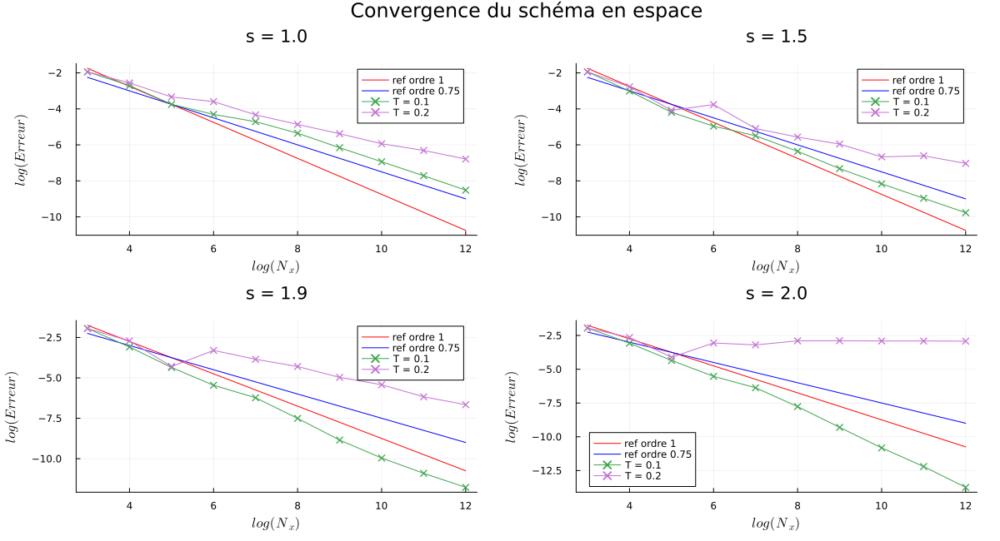

In [40]:
# Function to plot straight curve
courbe(pente::Real, x::Real, y::Real, span::AbstractVector) = (-pente*x + y) .+ pente .* span

# Plot
array_plt = []
for i ∈ eachindex(Array_s)
    plt = plot(margin = 0.5Plots.cm, size = (900,400))
    plot!(plt, pNₓ, courbe(-1, 5, log(err[1][1][3])./log(base), pNₓ) , label ="ref ordre 1", size = (900,400), c=:red)
    plot!(plt, pNₓ, courbe(-0.75, 5, log(err[1][1][3])./log(base), pNₓ) , label ="ref ordre 0.75", size = (900,400), c=:blue)
    for (e, T) ∈ zip(err[i], Array_Tf)
        plot!(plt, pNₓ, log.(e[eachindex(pNₓ)]) ./ log(base), label ="T = "*string(T), shape =:x)
    end
    xlabel!(L"log(N_x)")
    ylabel!(L"log(Erreur)")
    title!("s = "*string(Array_s[i]))
    push!(array_plt, plt)
end

plot(array_plt..., layout = (2,2),  plot_title = "Convergence du schéma en espace", size = (1200,650), margin = 0.5Plots.cm)

On remarque que qu'importe la valeur de $s$, il y a une perte d'ordre de convergence au passage de la discontinuité. On remarque quel'ordre de convergence varie avec $s$ : plus $s$ est proche de $2$, plus l'ordre de convergence avant la discontinuité est proche de $1$ et est supérieur à $1$ lorsque $s=2$. On remarque aussi que plus $s$ est grand, plus il y a une perte d'ordre important au passage de la discontinuité. Elle est proche de $0.75$ pour $s<2$. Pour $s=2$, comme on pouvait s'y attendre au vue des instabilités, il n'y a plus de convergence au delà de la discontinuité.